In [1]:
# ライブラリのインポート
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeRegressor # 回帰木モデルを作成するクラス
from model import ESN, Tikhonov #ESN,リッジ回帰をインポート
from sklearn.model_selection import train_test_split
import time
from sklearn.metrics import mean_squared_error
import seaborn as sns
import japanize_matplotlib
import my_functions_ver3
import datetime

In [2]:
# csvファイルの読み込み
df = pd.read_csv('Time_Series.csv', encoding = "shift-jis")

In [3]:
# 配列
tree_score = []
esn_score = []
com_score = []
df_columns = df.columns

# 定数
DF_LENGTH = len(df_columns) - 1

In [4]:
# 終値の取得
all_close_price_list = [''] * (DF_LENGTH+1)
for i in range(len(df_columns)):
    all_close_price_list[i] = my_functions_ver3.get_closing_price(df, df_columns[i])

# 収益率への変換
all_profit_rate_list = [''] * (DF_LENGTH+1)
for i in range(len(df_columns)):
    all_profit_rate_list[i] = my_functions_ver3.convert_raw_to_return(all_close_price_list[i])
del all_profit_rate_list[0] # インデックスの配列は削除

# データの整形
all_x_list = []
all_y_list = []
for i in range(DF_LENGTH):
    all_x_list.append(np.array(my_functions_ver3.sliding_window(all_profit_rate_list[i])[0]))
    all_y_list.append(np.array(my_functions_ver3.sliding_window(all_profit_rate_list[i])[1]))
    
# データ分割
all_x_train_list = []
all_x_test_list = []
all_y_train_list = []
all_y_test_list = []
for i in range(DF_LENGTH):
    all_x_train_list.append(train_test_split(all_x_list[i], all_y_list[i], test_size=0.1, shuffle=False)[0])
    all_x_test_list.append(train_test_split(all_x_list[i], all_y_list[i], test_size=0.1, shuffle=False)[1])
    all_y_train_list.append(train_test_split(all_x_list[i], all_y_list[i], test_size=0.1, shuffle=False)[2])
    all_y_test_list.append(train_test_split(all_x_list[i], all_y_list[i], test_size=0.1, shuffle=False)[3])


# 確認用
print("株式数：", len(all_profit_rate_list))
print("1株当たりのデータ数：", len(all_profit_rate_list[0]))

株式数： 150
1株当たりのデータ数： 4894


C:\Users\msmn\00JN\2022.10 combinationmodel\my_functions_ver3.py:171: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(20, 20))


elapsed_time:119.44070529937744[sec]


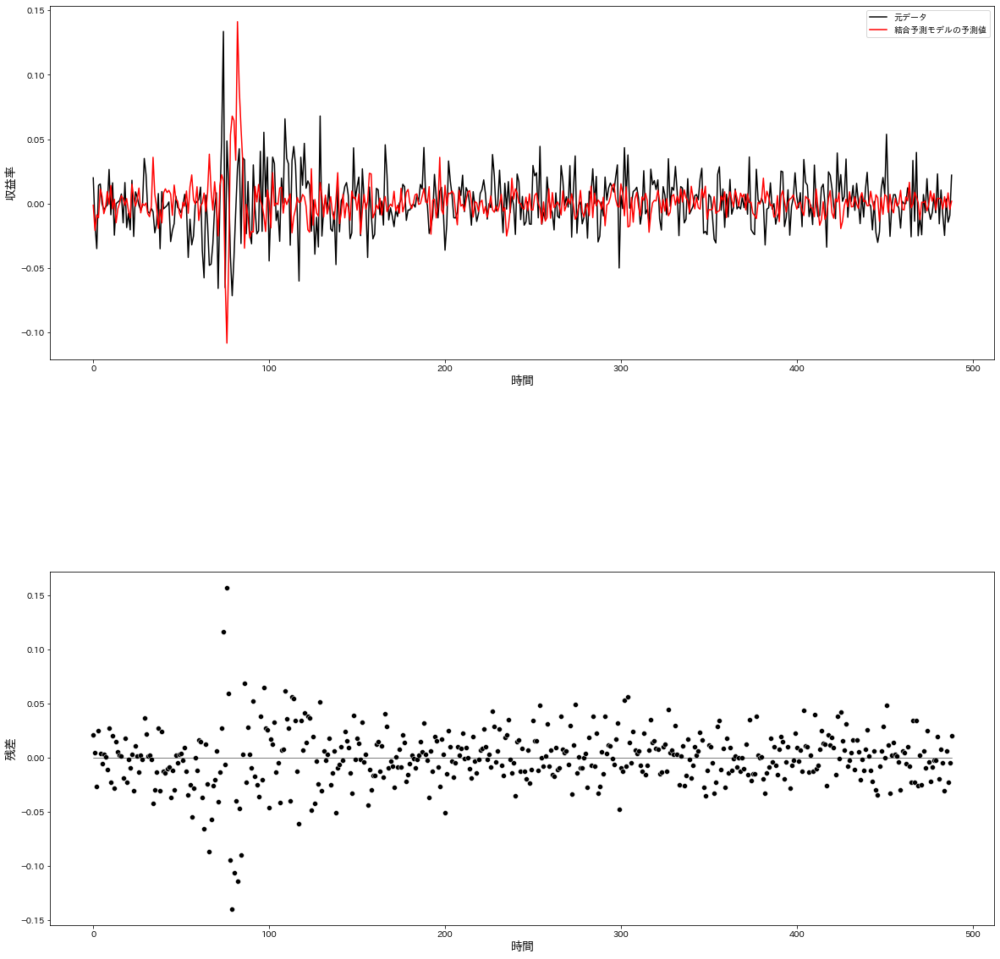

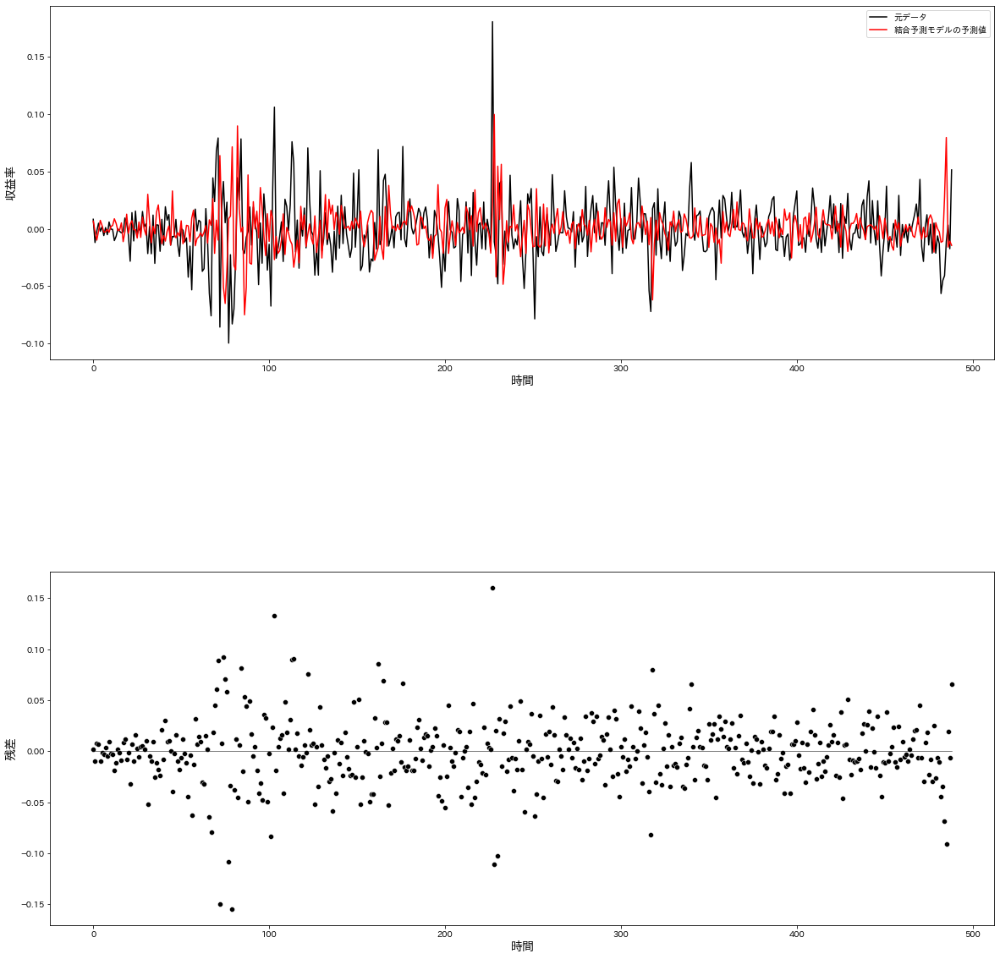

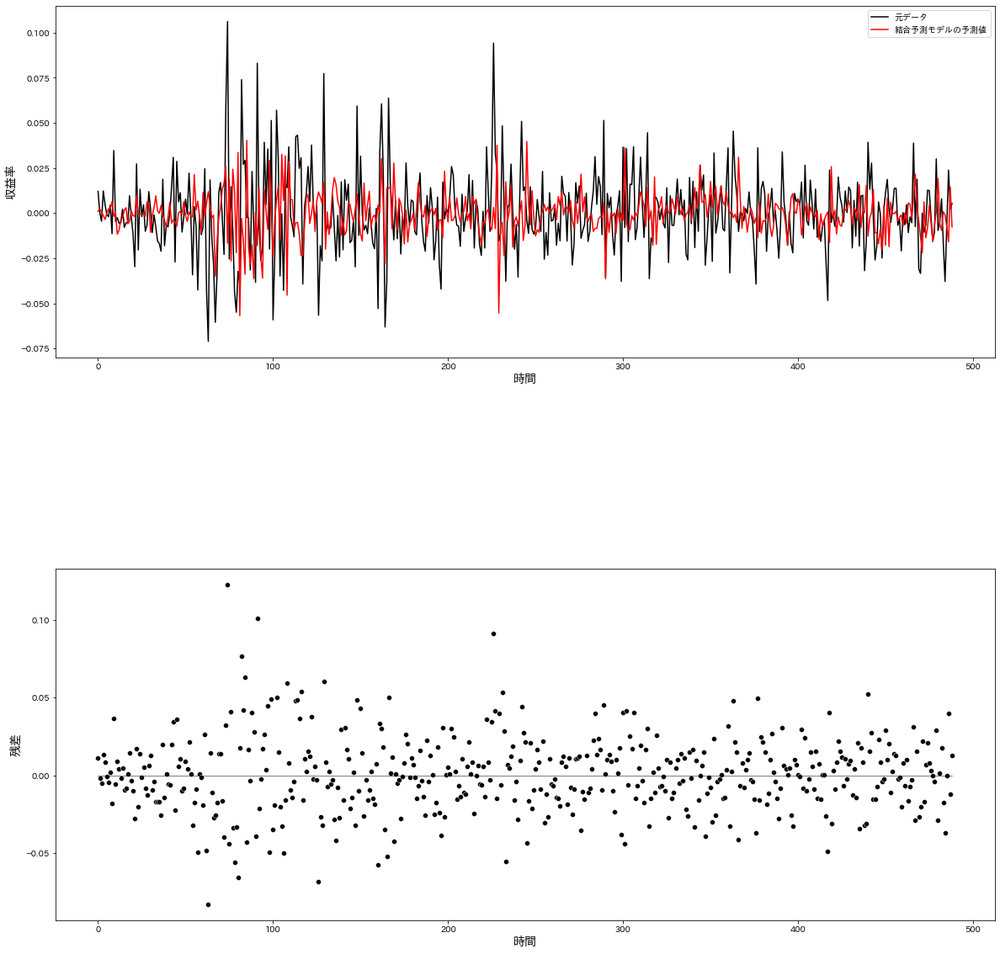

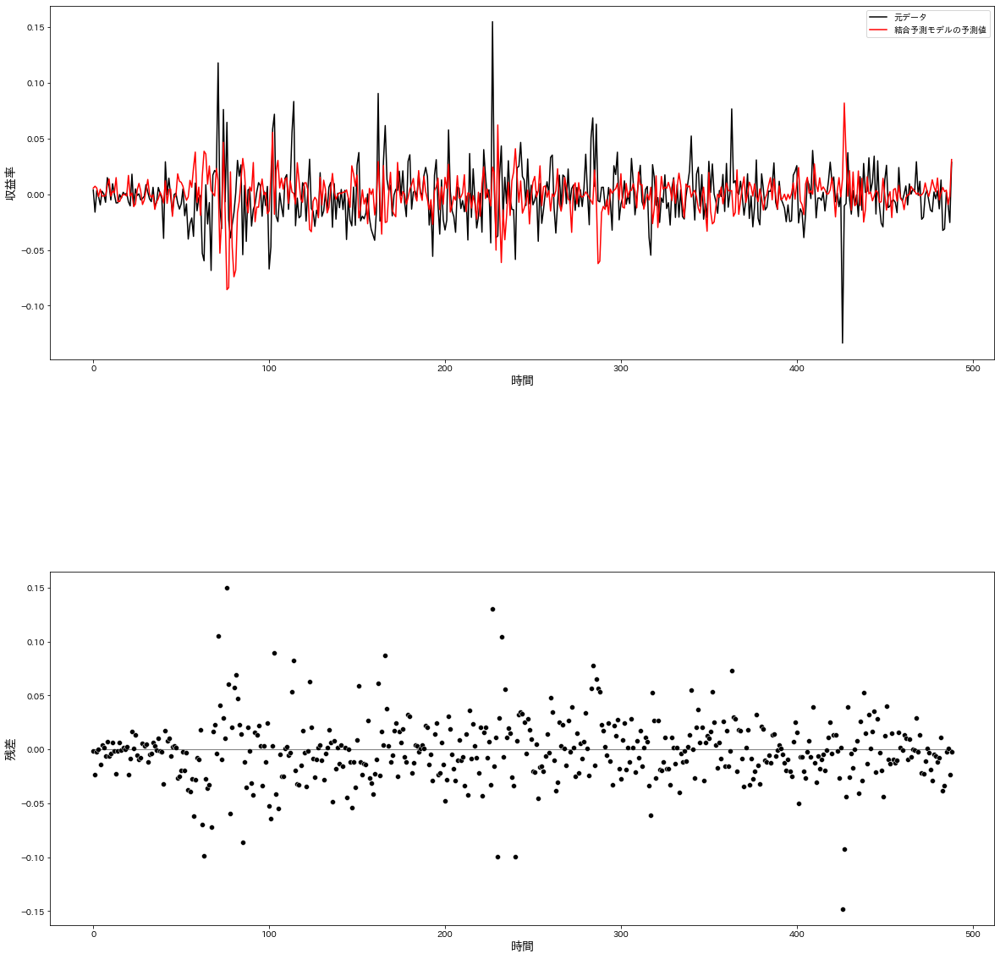

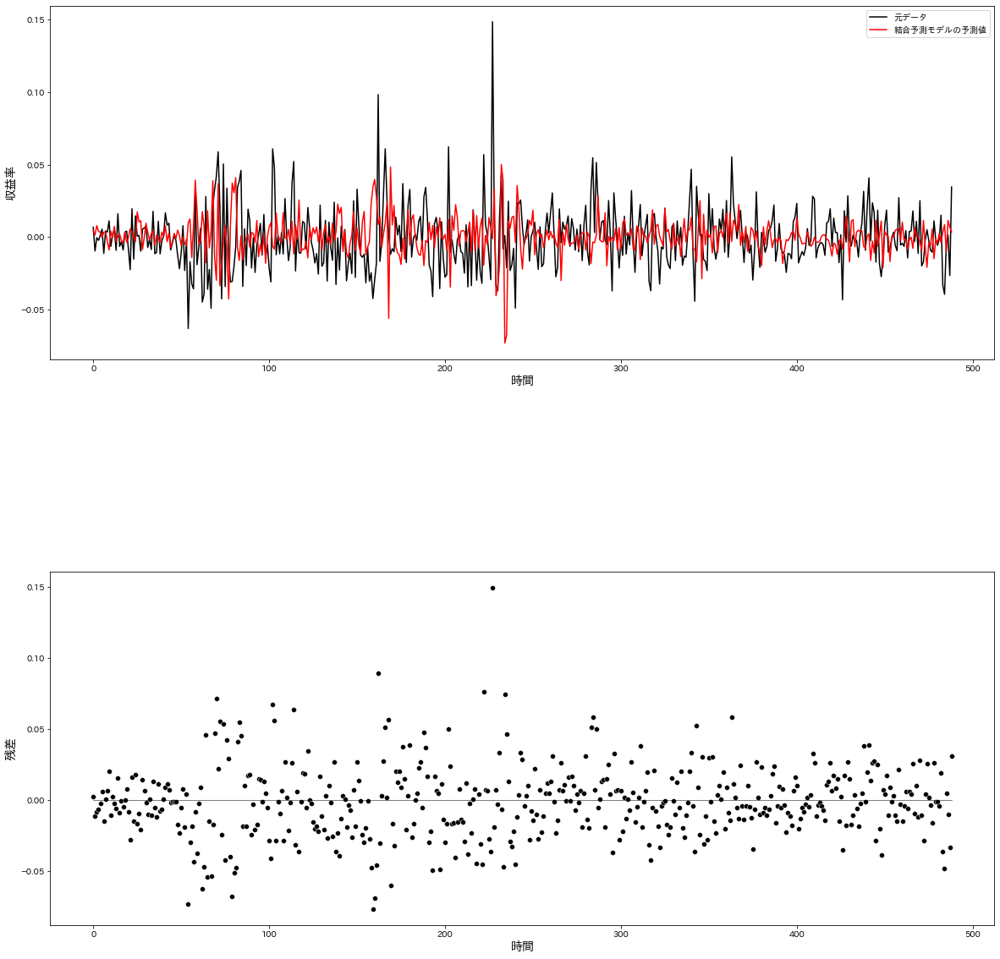

...

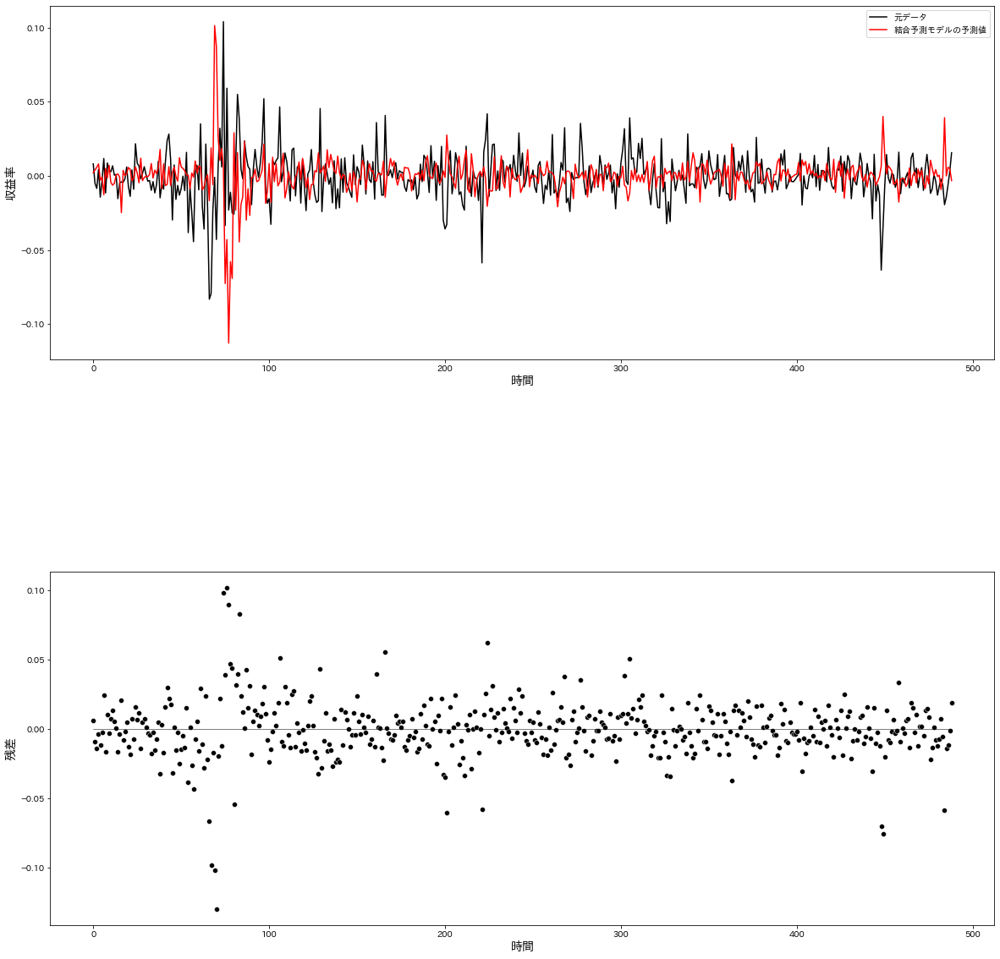

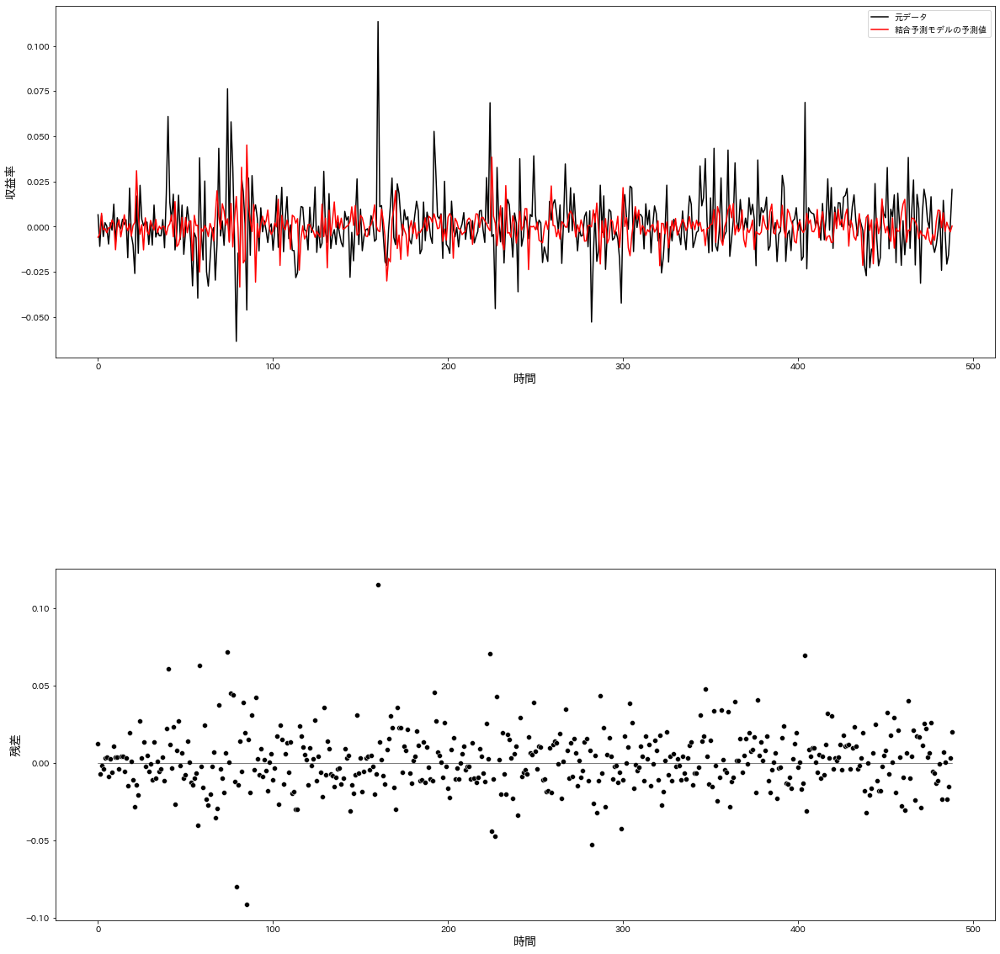

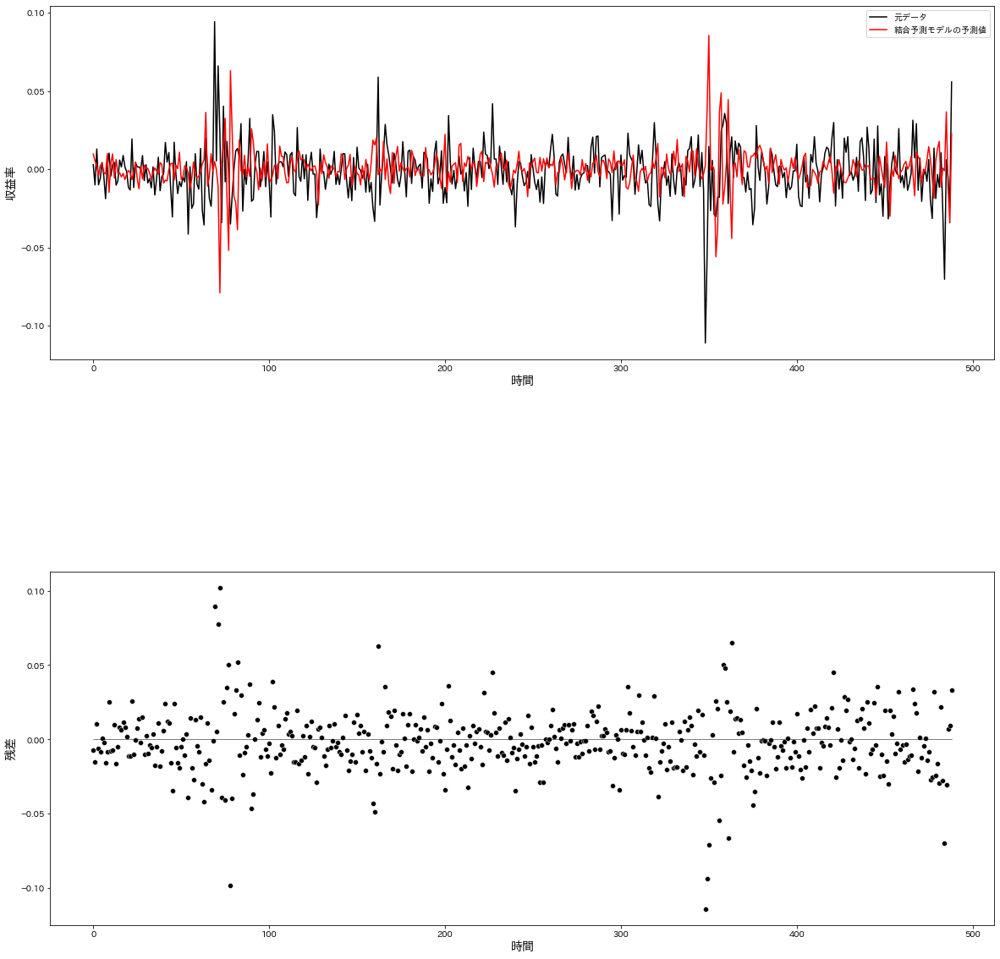

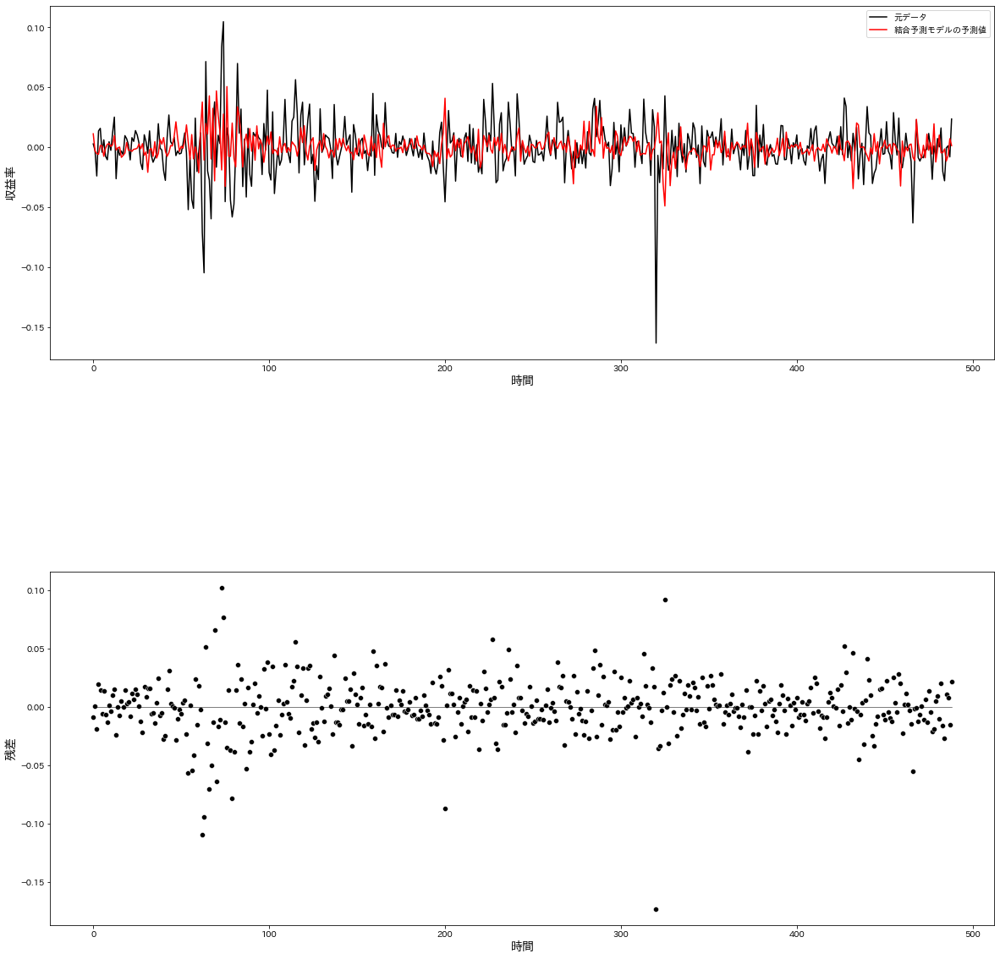

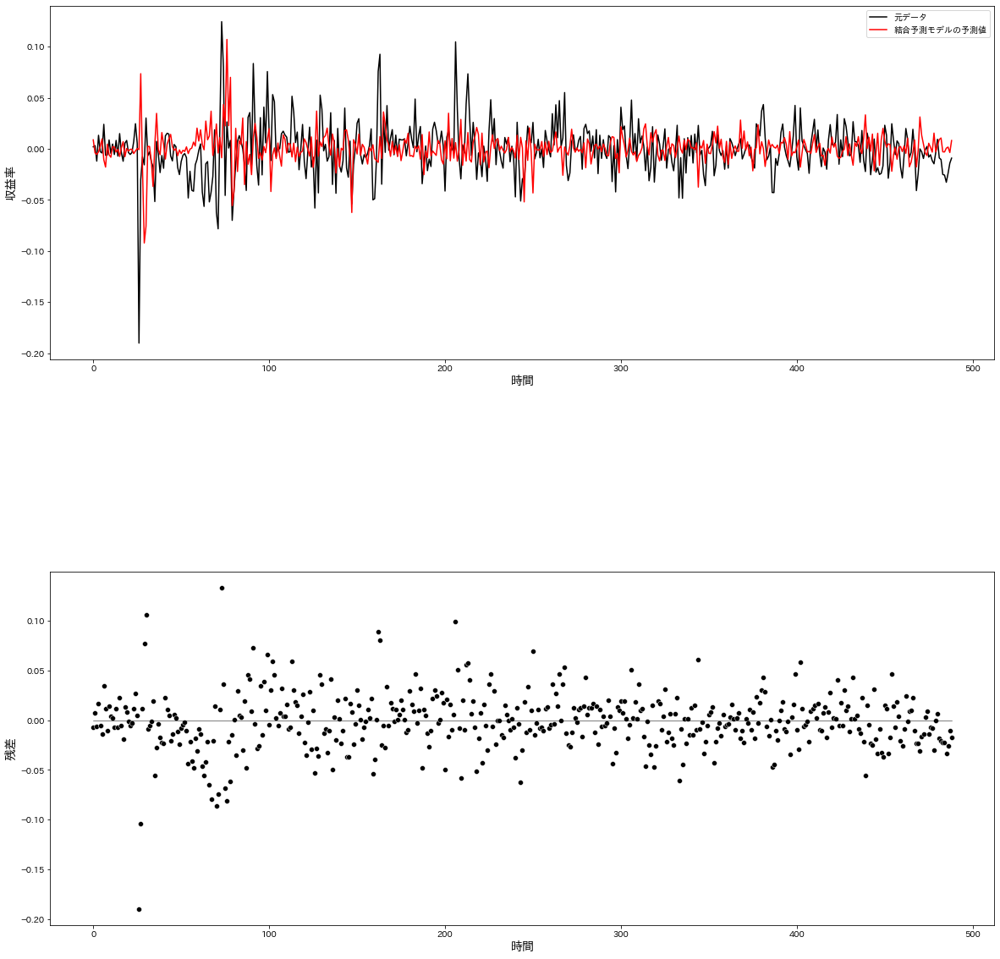

In [5]:
# 予測の実行
start = time.time()

for target_num in range(len(df_columns)-1):
    
    # モデル作成 - 決定木
    reg = DecisionTreeRegressor()
    model = reg.fit(all_x_train_list[target_num], all_y_train_list[target_num])
    tree_pred = model.predict(all_x_test_list[target_num])

    # モデル作成 - ESN
    N_x = 300
    ESNmodel = ESN(all_x_train_list[target_num].shape[1], 1, N_x, density=0.05, input_scale=1.0, rho=0.8, leaking_rate=1.0)
    ESNmodel.train(all_x_train_list[target_num], all_y_train_list[target_num], Tikhonov(N_x, 1, 0.0))
    esn_pred = ESNmodel.predict(all_x_test_list[target_num])

    esn_pred_list = []
    for i in range(len(esn_pred)):
        esn_pred_list.append(esn_pred[i][0])
        
    # 信頼度による結合
    tree_mse = mean_squared_error(all_y_test_list[target_num], tree_pred)
    esn_mse = mean_squared_error(all_y_test_list[target_num], esn_pred_list)
    tree_w = 1 / tree_mse
    esn_w = 1 / esn_mse
    combination_list = []
    for i in range(len(tree_pred)):
        combination_list.append((tree_pred[i] * tree_w + esn_pred_list[i] * esn_w) / (tree_w + esn_w))
        
    tree_score.append(my_functions_ver3.calc_kld(all_y_test_list[target_num], tree_pred))
    esn_score.append(my_functions_ver3.calc_kld(all_y_test_list[target_num], esn_pred_list))
    com_score.append(my_functions_ver3.calc_kld(all_y_test_list[target_num], combination_list))
    
    # 予測時間計測の際はコメントアウト
    my_functions_ver3.vis(df_columns, target_num, all_y_test_list, pred_array = combination_list, color = 'red', label='結合予測モデルの予測値')
        
# 実行時間の出力
elapsed_time = time.time() - start
print ("elapsed_time:{0}".format(elapsed_time) + "[sec]")

In [6]:
#pd.DataFrame(np.column_stack([df_columns[1:151], tree_score, esn_score, com_score])).to_excel(datetime.datetime.now().strftime('%Y%m%d_%H') + '_com_score.xlsx')

In [7]:
#186.59998536109924[sec]